In [52]:
import os,sys,re,time
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation

In [320]:
L = 100
tau = 2.e-5
c = 6260.
K = 50
h = L/K
CR = c*tau/h
t = 0
p = np.zeros(int(L/h) + 2)
ro = np.zeros(int(L/h) + 2)
p[1]  = 100

In [321]:
ro_fin = []
p_fin = []
_ro = np.copy(ro)
_p = np.copy(p)
for i in range(1000):
    ro_fin.append(_ro)
    p_fin.append(_p)
    _ro = _ro + CR * (np.concatenate((p_fin[i][1:], np.zeros(1)), axis=None) - ((np.concatenate((np.zeros(1), p_fin[i][:-1]), axis=None))))
    _p = _p + CR * (np.concatenate((ro_fin[i][1:], np.zeros(1)), axis=None) - ((np.concatenate((np.zeros(1), ro_fin[i][:-1]), axis=None))))
    #print(p_fin[0])

In [241]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams["animation.html"] = "jshtml"
import matplotlib.animation
import numpy as np
matplotlib.rcParams['animation.embed_limit'] = 2**128

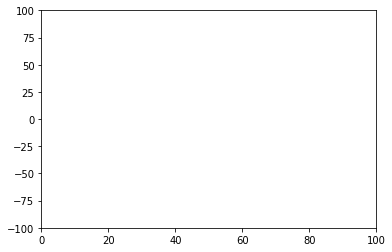

In [322]:
fig = plt.figure()
ax = plt.axes(xlim=(0, 100), ylim=(-100,100))
line, = ax.plot([], [], lw=2)

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# animation function.  This is called sequentially
def animate(i):
    x = np.linspace(0, 100, 52)
    y = p_fin[i]
    line.set_data(x, y)
    return line,

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=1000, init_func=init)
ani

In [314]:
L = 100
tau = 2.e-4
c = 7260.
K = 50
h = L/K
CR = c*tau/h
t = 0
p = np.zeros(int(L/h) + 2)
ro = np.zeros(int(L/h) + 2)
p[1]  = 200

In [315]:
ro_fin = []
p_fin = []
_ro = np.copy(ro)
_p = np.copy(p)
for i in range(300):
    ro_fin.append(_ro)
    p_fin.append(_p)
    _ro = (1 - CR)*_ro + \
          CR/2 * (np.concatenate((ro_fin[i][1:], np.zeros(1)), axis=None) + 
                  np.concatenate((np.zeros(1), ro_fin[i][:-1]), axis=None)) - \
          CR/2 * (np.concatenate((p_fin[i][1:], np.zeros(1)), axis=None) - 
                  np.concatenate((np.zeros(1), p_fin[i][:-1]), axis=None))
    _ro[-1] = 0
    _ro[0] = 0
    _p = (1 - CR)*_p + \
          CR/2 * (np.concatenate((p_fin[i][1:], np.zeros(1)), axis=None) +
                  np.concatenate((np.zeros(1), p_fin[i][:-1]), axis=None)) - \
          CR/2 * (np.concatenate((ro_fin[i][1:], np.zeros(1)), axis=None) -
                  np.concatenate((np.zeros(1), ro_fin[i][:-1]), axis=None))

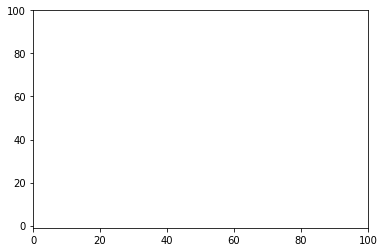

In [316]:
fig = plt.figure()
ax = plt.axes(xlim=(0, 100), ylim=(-1,100))
line, = ax.plot([], [], lw=2)

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# animation function.  This is called sequentially
def animate(i):
    x = np.linspace(0, 100, 51)
    y = p_fin[i][:-1]
    line.set_data(x, y)
    return line,

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=200, init_func=init)
ani